In [36]:
import re
import pandas as pd
import ast
import spacy
import numpy as np
import seaborn as sns
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
nlp = spacy.load("en_core_web_sm")



In [ ]:
df = pd.ExcelFile('TRAIN.xlsx').parse()
print(df)

FileNotFoundError: [Errno 2] No such file or directory: 'TRAIN.xlsx'

In [ ]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52499 entries, 0 to 52498
Data columns (total 1 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  52499 non-null  object
dtypes: object(1)
memory usage: 410.3+ KB
None


In [ ]:
df.columns = ['text']

In [ ]:
print(df['text'][0])
print(type(df['text'][0]))

[('03/01/2001', 'NUM'), ('01:35', 'NUM'), ('PM', 'NOUN')]
<class 'str'>


In [ ]:
list_df = []
for i in range(df.size):
  tag_list = ast.literal_eval(df['text'][i])
  tag_df = pd.DataFrame(tag_list)
  tag_df = tag_df.applymap(str)
  list_df.append(tag_df)
df = list_df

<ipython-input-5-bb72c0e074e7>:5: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  tag_df = tag_df.applymap(str)


In [ ]:
print((df[0]))


            0     1
0  03/01/2001   NUM
1       01:35   NUM
2          PM  NOUN


In [ ]:
print(type(df))
print(df[:2])

NameError: name 'df' is not defined

In [ ]:
# removeSpecialCharactersFromWord():
# - It removes all the ambigous symbol in numbers to consider it as NUM, since there can be infinite possibilities for it
# - Examples:
#   Date: "14-2-25" will change to "14225"
#   Currency: "$24" will change to "24"
#   Decimals: "1.43" will change to "143"

def removeSpecialCharactersFromWord(text):
    return re.sub(r'[^\w\s\d]+(?=\d)|(?<=\d)[^\w\s\d]+', '', text)

In [ ]:
# replaceIntegerWithOne():
# - It makes most integers value to "1" as a representation, so that unique words have lesser values and there can be infinitely many numbers and it cannot handle each case (highly expensive computationally).
# - Example:
#   "14225" will change to "1"
#   "abc123" will not change as it can be a username and not number
#   It mostly change if there is soleley only numbers and nothing else

def replaceIntegersWithOne(text):
    return re.sub(r'\b\d+\b', '1', text)


In [ ]:
# This apply both the function above mentioned with lemmatization to make similar looking words to one word

for i in range(len(df)):
  for j in range(len(df[i])):
    df[i].iloc[j, 0] = nlp(replaceIntegersWithOne(removeSpecialCharactersFromWord(df[i].iloc[j, 0])).lower())[0].lemma_

In [ ]:
df[0]

,0
0,"0 1\n1 1\n2 pm\nName: 0, dtype: object"
1,"0 NUM\n1 NUM\n2 NOUN\nName: 1, dtyp..."


In [ ]:
# It traverses the df and convert the sentence into a 2d list , i.e. first index suggest that it's which sentence and 2nd index is for the word in the specific sentence
sentence_structure = []
for i in range(len(df)):
  sentence =[]
  for j in range(len(df[i])):
    sentence.append((df[i].iloc[j, 0], df[i].iloc[j, 1]))
  sentence_structure.append(sentence)

print(sentence_structure)

In [ ]:
# It converts the sentence_Structure to a xlsx sheet, so that every time we need to again to computation such as lemmetization as it takes time. On average it take approx 2 hrs.
ds = pd.DataFrame(sentence_structure)
ds.to_excel("processed.xlsx", index=False, header=False)

In [10]:
# To read the lemmetized sentence stored in excel sheet
train_df = pd.read_excel('processed.xlsx', header=None)

print(train_df.head())

                 0                     1                  2    \
0       ('1', 'NUM')          ('1', 'NUM')     ('pm', 'NOUN')   
1     ('the', 'DET')  ('industry', 'NOUN')   ('have', 'VERB')   
2   ('love', 'VERB')       ('this', 'DET')  ('place', 'NOUN')   
3    ('this', 'DET')   ('problem', 'NOUN')      ('of', 'ADP')   
4  ('esso', 'PROPN')       ('say', 'VERB')         ('1', 'X')   

               3                   4                    5    \
0              NaN                 NaN                  NaN   
1  ('say', 'VERB')        ('1', 'NUM')       ('be', 'VERB')   
2   ('!', 'PUNCT')                 NaN                  NaN   
3   ('the', 'DET')  ('optimum', 'ADJ')  ('balance', 'NOUN')   
4   ('the', 'DET')  ('white', 'PROPN')    ('field', 'NOUN')   

                 6                       7                     8    \
0                NaN                     NaN                   NaN   
1       ('a', 'DET')         ('poor', 'ADJ')      ('year', 'NOUN')   
2                NaN

In [11]:
# extract_words_and_pos() converts the data frame into list of tuple with the word and pos tag and ignore all the Nan values
# Example:
# First sentece = [('1', 'NUM'),('1', 'NUM'),('pm', 'NOUN')]   i.e. also removed NaN values as it's unnecessary
def extract_words_and_pos(row):
    word_pos_list = []
    for item in row:
        if pd.notnull(item):  # to skip NaN values
            try:
                parsed_item = ast.literal_eval(item)
                if isinstance(parsed_item, tuple) and len(parsed_item) == 2: # to check that the item is of size 2 i.e. (word,pos) and nothing unambiguos
                    word_pos_list.append(parsed_item)
            except (SyntaxError, ValueError):
                print(f"Skipping invalid item: {item}")
    return word_pos_list


In [14]:
# It applies extract_words function to get train
train_df = train_df.apply(extract_words_and_pos, axis=1)

In [15]:
# It convert it into a 2d List to make it easily to access and compute the algorithm
word_pos_list_train = train_df.tolist()


In [16]:
word_pos_list_train[0][0][0]

'1'

In [17]:
# This is done to get unique words and tags to do further preprocessing
flattened_list = [item for sublist in word_pos_list_train for item in sublist]

# It uses set as it stores all unique values
unique_words = set(word for word, pos in flattened_list)
unique_tags = set(pos for word, pos in flattened_list)

print(len(unique_words))
print(unique_tags)


31774
{'X', 'ADJ', 'AUX', 'SYM', 'PART', 'PRON', '.', 'CONJ', 'VERB', 'CCONJ', 'PROPN', 'SCONJ', 'DET', 'INTJ', 'NUM', 'PUNCT', 'ADP', 'PRT', 'NOUN', 'ADV', '_'}


In [ ]:
# It's used to get all the words with different meanings like it can be URL, email, file, punctuation marks, abbreviation or some unnecessary words that are ambiguous
filtered_strings = [text for text in unique_words if "@" in text or "." in text]

print("Filtered Strings:")
for string in filtered_strings:
    print(string)

Filtered Strings:
-final.doc


In [18]:
# preprocess_set() is a function to convert special meaning words to a specific unique words to avoid making the unique words huge for the matrix. It's also possible that there can be infinitely many values for the strings like username, or url.
# Example:
# - "abcd@gmail.com" will convert to "<EMAIL>"
# - "readme.xlsx" will convert to "<FEXT>"
# - "https://colab.research.google.com" will convert to "<URL>"
# - "goggle.com" will convert to "<DOMAIN>"
# - "!!" will convert to "<PUNCT>"
# - "u.s.s.r" will convert to "<ABBREV>" (it may be some short form)
# - "a." will convert to "<AMBIG>" (doesn't hold any meaning)
# - "&" will conver to "<SPECIAL_CHAR>"


# Note: there were words with @enron and other which were also considered
def preprocess_set(text):
    # Define regex patterns for specific cases
    email_pattern = re.compile(r'\b[A-Za-z0-9._%+-]+@(?:enron(?:_[a-zA-Z0-9]+)?|ect|ev1net|transrede|[A-Za-z0-9.-]+\.[A-Za-z]{2,})\b')

    # Domain pattern: Includes enron-related domains and general domains like .com, .net, .org, etc.
    domain_pattern = re.compile(r'\b(?:enron(?:_[a-zA-Z0-9]+)?|ect|ev1net|transrede|[A-Za-z0-9.-]+\.(?:com|net|org|edu|gov|mil|int|info|biz|co\.[a-zA-Z]{2,}))\b')


    file_extension_pattern = re.compile(r'\b-?\w+\.\w{2,}\b')


    # Specific abbreviations: "co.", "vs." remain under abbreviations
    abbreviation_pattern = re.compile(r'\b[a-zA-Z]{1,4}\.\b')
    abbreviations_with_period = re.compile(r'\b[a-zA-Z]+\.(?!-)')
    hyphenated_words =  re.compile(r'\b[a-zA-Z.]+(?:-[a-zA-Z.]+)+')
    file_extensions = re.compile(r'\.[a-zA-Z0-9]+\b')
    standalone_abbrev = re.compile(r'\b[a-zA-Z]+\.\b')


    # Single-letter abbreviations: "a.", "b.", "j." should be in dots
    # Multi-word hyphenated terms like "st.-pol." also go under dots
    dots_pattern = re.compile(r'\.{2,}' )
    ambiguous_pattern = re.compile(r'(?<!\w)[a-zA-Z]\.(?!\w)')
    # Special characters (symbols like %$#)
    special_pattern = re.compile(r'[^\w\s@.-]')

    # Punctuation marks
    punct_pattern = re.compile(r'[\.@,;!?]+')

    # URLs (HTTP and HTTPS links)
    url_pattern = re.compile(r'\bhttps?://[A-Za-z0-9.-]+\.[A-Za-z]{2,}\b')


    # Handle emails properly
    if re.match(email_pattern, text):
        #print(f"{text} <EMAIL>")
        return "<EMAIL>"

    # If it's a domain-like string (e.g., .com, .org, .edu) with "enron"
    elif re.match(domain_pattern, text):
        #print(f"{text} <DOMAIN>")
        return "<DOMAIN>"

    # If it's an HTTP or HTTPS URL
    elif re.match(url_pattern, text):
        #print(f"{text} <URL>")
        return"<URL>"

    # If it's a file extension (e.g., .doc, .vcf)
    elif re.match(file_extension_pattern, text):
        #print(f"{text} <FEXT>")
        return "<FEXT>"

    elif re.match(file_extensions, text):
        #print(f"{text} <FEXT>")
        return "<FEXT>"


    # If it's an abbreviation (e.g., 'j.', 'b.', etc.)
    elif re.match(abbreviation_pattern, text):
        #print(f"{text} <ABBREV>")
        return "<ABBREV>"

    elif re.match(abbreviations_with_period, text):
        #print(f"{text} <ABBREV>")
        return "<ABBREV>"
    # If it's a single punctuation mark
    elif re.match(punct_pattern, text):
        #print(f"{text} <PUNCT>")
        return "<PUNCT>"
    # If it contains special characters (e.g., %$#)
    elif re.search(special_pattern, text):
        #print(f"{text} <SPECIAL_CHAR>")
        return "<SPECIAL_CHAR>"


    elif re.match(dots_pattern, text):
        #print(f"{text} <AMBIG>")
        return "<AMBIG>"
    elif re.match(standalone_abbrev, text):
        print(f"{text} <AMBIG>")
        return "<AMBIG>"
    elif re.match(hyphenated_words, text):
        #print(f"{text} <AMBIG>")
        return "<AMBIG>"
    else:
         return text


In [19]:
# It applies to get whether the word is used for a specific domain like url, email, file extension or something like
word_pos_list_train = [
    [(preprocess_set(word), pos) for word, pos in sublist] for sublist in word_pos_list_train
]

In [20]:
# It's used to get unique words and pos tags to understand about training dataset
flattened_list = [item for sublist in word_pos_list_train for item in sublist]

# Extract unique words and POS tags
unique_words = set(word for word, pos in flattened_list)
unique_tags = set(pos for word, pos in flattened_list)

print(len(unique_words))
print(unique_tags)


31037
{'X', 'ADJ', 'AUX', 'SYM', 'PART', 'PRON', '.', 'CONJ', 'VERB', 'CCONJ', 'PROPN', 'SCONJ', 'DET', 'INTJ', 'NUM', 'PUNCT', 'ADP', 'PRT', 'NOUN', 'ADV', '_'}


In [21]:
print(unique_words)

{'engrave', 'regulative', 'stansbery', 'committeeman', 'dock', 'procurer', 'unwary', 'kaminsky', 'observe', 'eyedropper', 'conventionally', 'fernando', 'barn', 'paraphrase', 'subsidiary', 'uptown', 'luce', 'quatrain', 'gerbil', 'adolescent', 'forbes', 'vehicle', 'future', 'analogous', '10day', 'topsoil', 'antiquity', 'jen', 'johann', 'heretic', 'boland', 'acquirer', 'shatterproof', 'poncho', 'thamnophis', 'harlan', '230mbf', 'frick', 'calamitous', 'crispin', 'coast', 'liberate', 'broglie', 'alway', 'practise', 'desultory', 'completely', 'posada', 'woul', 'compulsory', 'diy', 'misfire', 'arleigh', 'fantasist', 'prepositional', 'laughlin', 'oneupmanship', 'koenigsberg', 'ledge', 'retrace', 'violation', 'bricklaying', 'lick', 'indigenous', 'appearin', 'busybody', 'bewhisker', 'wastage', 'linen', 'furtive', 'etiquette', 'petrarchan', 'rhythmical', 'depress', 'antinomian', 'inglorious', 'electromyography', 'mcnear', 'sesshu', 'sorry', 'weld', 'preside', 'equ', 'trick', 'burke', 'crappy', 'h

In [22]:
# It add the word "start" to every sentence to know the starting probability of a tag as mentioned in Hidden Marknov Model

word_pos_list_train = [
    [("", "start")] + [(word, pos) for word, pos in sublist]
    for sublist in word_pos_list_train
]


In [23]:
# word_list is used so that changes made does not change the original list of sentences.
word_list = word_pos_list_train

In [24]:
word_list[0]

[('', 'start'), ('1', 'NUM'), ('1', 'NUM'), ('pm', 'NOUN')]

In [25]:
# This was done as a trial to calculate the matrix for emission probability matrix
pair_counts = defaultdict(int)
pos_counts = defaultdict(int)

# iterate through each sentence and extract POS tag pairs
for sentence in word_pos_list_train:
    for i in range(len(sentence) - 1):
        curr_pos = sentence[i][1]
        next_pos = sentence[i + 1][1]
        pair_counts[(curr_pos, next_pos)] += 1
        pos_counts[curr_pos] += 1

# Calculate probabilities
transition_probs = defaultdict(dict)
for pair, count in pair_counts.items():
    curr_pos, next_pos = pair
    transition_probs[curr_pos][next_pos] = count / pos_counts[curr_pos]

# To print the emission probabilities
for curr_pos, next_pos_probs in transition_probs.items():
    for next_pos, prob in next_pos_probs.items():
        print(f"P({curr_pos}|{next_pos}) = {prob:.4f}")

P(start|NUM) = 0.0227
P(start|DET) = 0.1990
P(start|VERB) = 0.0492
P(start|PROPN) = 0.0411
P(start|PRON) = 0.1614
P(start|NOUN) = 0.1240
P(start|ADP) = 0.1125
P(start|AUX) = 0.0065
P(start|.) = 0.0442
P(start|PRT) = 0.0237
P(start|CCONJ) = 0.0054
P(start|INTJ) = 0.0085
P(start|ADV) = 0.0853
P(start|SCONJ) = 0.0087
P(start|CONJ) = 0.0370
P(start|_) = 0.0106
P(start|PUNCT) = 0.0097
P(start|X) = 0.0060
P(start|ADJ) = 0.0416
P(start|SYM) = 0.0017
P(start|PART) = 0.0013
P(NUM|NUM) = 0.0538
P(NUM|NOUN) = 0.3637
P(NUM|VERB) = 0.0356
P(NUM|ADJ) = 0.0503
P(NUM|.) = 0.1860
P(NUM|PROPN) = 0.0112
P(NUM|AUX) = 0.0025
P(NUM|X) = 0.0383
P(NUM|ADP) = 0.1089
P(NUM|DET) = 0.0106
P(NUM|PUNCT) = 0.0658
P(NUM|SYM) = 0.0085
P(NUM|CONJ) = 0.0266
P(NUM|PRON) = 0.0075
P(NUM|ADV) = 0.0150
P(NUM|PRT) = 0.0038
P(NUM|PART) = 0.0035
P(NUM|CCONJ) = 0.0066
P(NUM|_) = 0.0006
P(NUM|SCONJ) = 0.0008
P(NUM|INTJ) = 0.0001
P(DET|NOUN) = 0.6086
P(DET|ADJ) = 0.2419
P(DET|PROPN) = 0.0169
P(DET|VERB) = 0.0580
P(DET|NUM) = 0.011

In [81]:
# It creates a transmission matrix as mentioned in Hidden Markinov Model

# Extract all unique POS tags

unique_tags = sorted({pos for sentence in word_pos_list_train for _, pos in sentence})
tag_index = {tag: i for i, tag in enumerate(unique_tags)}

# Initialize transition matrix (zero for missing transitions)
num_tags = len(unique_tags)
transition_matrix = np.zeros((num_tags, num_tags))

# Count occurrences of POS tag transitions
pos_counts = defaultdict(int)
for sentence in word_pos_list_train:
    for i in range(len(sentence) - 1):
        curr_pos = sentence[i][1]
        next_pos = sentence[i + 1][1]
        transition_matrix[tag_index[curr_pos]][tag_index[next_pos]] += 1
        pos_counts[curr_pos] += 1

# Convert counts to probabilities
for i, curr_tag in enumerate(unique_tags):
    total = pos_counts[curr_tag]
    if total > 0:
        transition_matrix[i] /= total
# To print the transition matrix
print("\nTransition Probability Matrix:\n")
print("    " + "  ".join(unique_tags))  # Print column headers
for i, row in enumerate(transition_matrix):
    formatted_row = "  ".join(f"{prob:.3f}" for prob in row)
    print(f"{unique_tags[i]:<3} {formatted_row}")  # Print row with POS label


Transition Probability Matrix:

    .  ADJ  ADP  ADV  AUX  CCONJ  CONJ  DET  INTJ  NOUN  NUM  PART  PRON  PROPN  PRT  PUNCT  SCONJ  SYM  VERB  X  _  start
.   0.154  0.050  0.112  0.070  0.000  0.000  0.114  0.116  0.000  0.143  0.023  0.000  0.067  0.000  0.024  0.000  0.000  0.000  0.126  0.002  0.000  0.000
ADJ 0.070  0.058  0.084  0.010  0.001  0.007  0.029  0.005  0.000  0.638  0.008  0.006  0.004  0.013  0.014  0.024  0.004  0.000  0.016  0.005  0.001  0.000
ADP 0.008  0.087  0.021  0.016  0.000  0.001  0.002  0.433  0.000  0.245  0.035  0.000  0.069  0.027  0.011  0.004  0.000  0.000  0.036  0.004  0.001  0.000
ADV 0.115  0.144  0.131  0.097  0.009  0.006  0.012  0.071  0.000  0.030  0.015  0.004  0.049  0.002  0.021  0.034  0.007  0.001  0.242  0.007  0.003  0.000
AUX 0.000  0.110  0.033  0.142  0.077  0.002  0.000  0.082  0.000  0.011  0.009  0.117  0.050  0.007  0.000  0.016  0.009  0.001  0.334  0.000  0.002  0.000
CCONJ 0.000  0.091  0.029  0.082  0.045  0.000  0.000  0.09

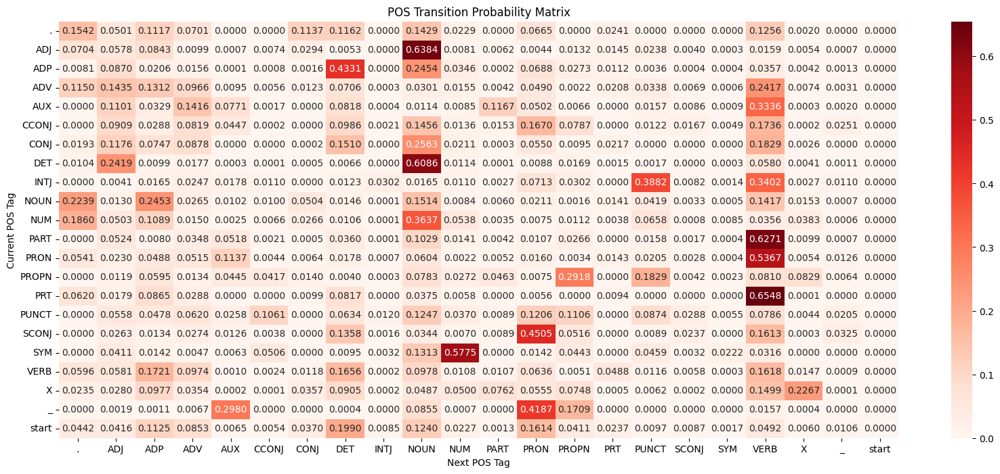

In [82]:
# It creates a Transmission Probability Matrix with Deeper red showing higher probability and vice versa.
plt.figure(figsize=(20, 8))
sns.heatmap(transition_matrix, annot=True, cmap="Reds", xticklabels=unique_tags, yticklabels=unique_tags, fmt=".4f")

plt.title("POS Transition Probability Matrix")
plt.xlabel("Next POS Tag")
plt.ylabel("Current POS Tag")
plt.show()

In [83]:
# It creates a emission probability matrix

unique_words = sorted({word for sentence in word_pos_list_train for word, _ in sentence})


# Add an extra "UNKNOWN" word i.e. for words to not fail if the word testing is not present in train model and given a equal probability that it can be any of the tags
# It can be more optimized as it cannot be PUNCT, or . as it's already handled
unique_words.append("UNKNOWN")

# it maps the word and pos tags to a particular index such that it can be used in matrix using numbers
word_index = {word: i for i, word in enumerate(unique_words)}
tag_index = {tag: i for i, tag in enumerate(unique_tags)}

# initialize transmission matrix i.e total unique words as rows and num_tags as columns
num_words = len(unique_words)
num_tags = len(unique_tags)
emission_matrix = np.zeros((num_words, num_tags))


word_tag_counts = defaultdict(int)
tag_counts = defaultdict(int)

for sentence in word_pos_list_train:
    for word, pos in sentence:
        emission_matrix[word_index[word]][tag_index[pos]] += 1
        word_tag_counts[(word, pos)] += 1
        tag_counts[pos] += 1

# Calculate probabilities P(pos | word)
# it avoids last as it's for unknown
for i, word in enumerate(unique_words[:-1]):
    total = sum(emission_matrix[i])
    if total > 0:
        emission_matrix[i] /= total

# Assign equal probabilities for the "UNKNOWN" word as it can be any of the tags
unknown_prob = 1 / num_tags
emission_matrix[-1, :] = unknown_prob


# Tried to do but could not print heatmap for the emission probability

# # Step 6: Plot heatmap
# plt.figure(figsize=(20, 40))
# sns.heatmap(transmission_matrix, annot=True, cmap="Blues", center=0.5,
#             xticklabels=unique_tags, yticklabels=unique_words, fmt=".4f")

# plt.title("Transmission Probability Matrix (P(POS | Word))")
# plt.xlabel("POS Tag")
# plt.ylabel("Word")
# plt.show()


In [30]:
# was done to check if certain word_index exist or not
word_index["<EMAIL>"]

487

In [ ]:
print(type(emission_matrix))

<class 'numpy.ndarray'>


In [87]:
# It saves the transmission and emission matrix with word and tag index locally so that it can be used without calculating it again
np.save("transmission_matrix.npy", transition_matrix)
np.save("emission_matrix.npy", emission_matrix)

np.save("word_index.npy", word_index)
np.save("tag_index.npy", tag_index)

In [84]:
transition_df = pd.DataFrame(transition_matrix)


In [85]:
emission_df = pd.DataFrame(emission_matrix)


In [86]:
# This was done to get POS tag for a sentence using Hidden Markinov Model with Viterbi Algorithm as discussed in class

sentence = "the fans watch the race .".split()

num_tags = len(unique_tags)
num_words = len(sentence)

# initializa a matrix for viterbi such that it's num_tags as rows and num_words as columns
viterbi = np.zeros((num_tags, num_words))

# initialize backpointer matrix for tags and total words for sentence
backpointer = np.zeros((num_tags, len(sentence)+1), dtype=int)

# initialization: Compute probabilities for the first word i.e using start
for i in unique_tags:
    current_tag = i
    # transition from start to current tag
    transition_prob = transition_df.loc[tag_index["start"],tag_index[current_tag]]
    # emission probability for first word
    emission_prob = emission_df.loc[word_index[sentence[0]],tag_index[current_tag]]

    # multiply transition and emission probabilities and store in respective tag index
    viterbi[tag_index[i], 0] = transition_prob * emission_prob


# compute probabilities for the rest of the words using previous probability
for t in range(1,len(sentence)):
    for i in unique_tags:
        current_tag = tag_index[i]
        max_prob = 0
        best_tag = 0
        for j in unique_tags:
            prev_tag = tag_index[j]

            # calculate transition and emission probabilities using prev tag and current tag
            transition_prob = transition_df.loc[prev_tag, current_tag]
            temp = sentence[t]
            if(temp not in unique_words):
                temp = "UNKNOWN"
            emission_prob = emission_df.loc[word_index[temp],current_tag]

            # compute the total probability and compare to find the maximum
            prob = viterbi[tag_index[j], t-1] * transition_prob * emission_prob
            if prob > max_prob:
                max_prob = prob
                best_tag = tag_index[j]

        # store the maximum probability and the best previous tag

        viterbi[tag_index[i], t] = max_prob
        backpointer[tag_index[i], t] = best_tag


# reconstruct the best tag sequence using backtracking by finding the max probability of the last word and then move to first index
best_tags = [0] * len(sentence)
best_tags[-1] = np.argmax(viterbi[:, len(sentence) - 1])

for t in range(len(sentence) - 2, -1, -1):
    best_tags[t] = backpointer[best_tags[t + 1], t + 1]

# find best_tags to corresponding tag labels

best_tag_sequence = []
for i in best_tags:
    for tag,index in tag_index.items():
        if index == i:
            best_tag_sequence.append(tag)
            break

# Print the best tag sequence for the sentence
print("Sentence:", " ".join(sentence))
print("Best tag sequence:", " ".join(best_tag_sequence))

Sentence: the fans watch the race .
Best tag sequence: DET NOUN VERB DET NOUN ADP


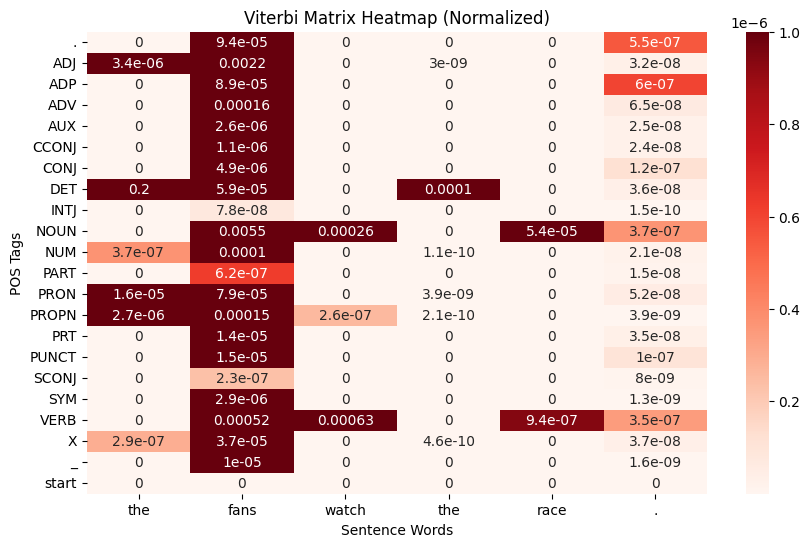

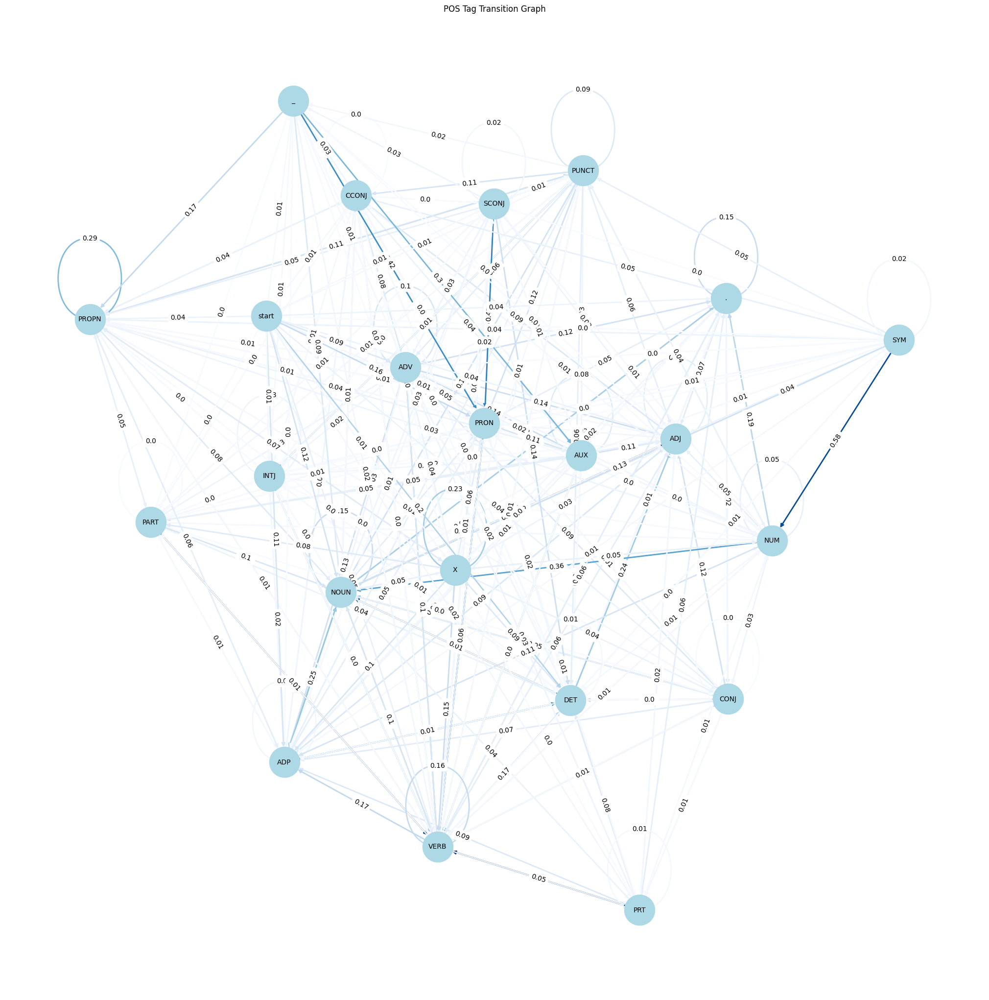

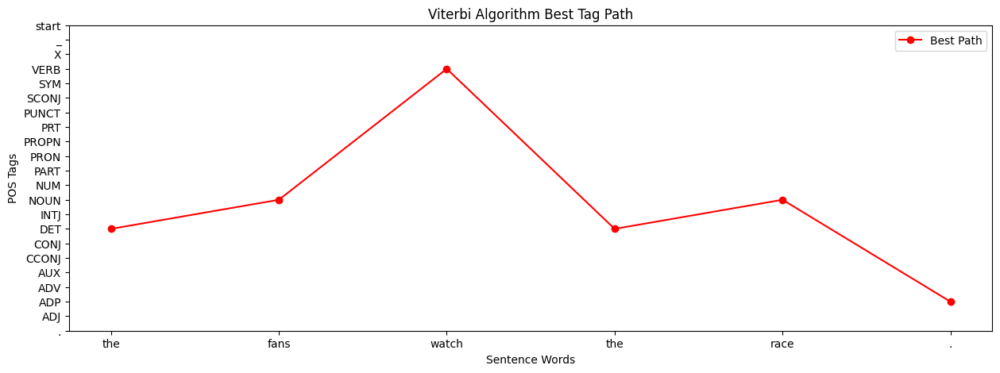

In [59]:
# This was done to visualize the algorithm

# Example sentence
sentence = ["the", "fans", "watch", "the", "race", "."]
num_tags = len(unique_tags)
num_words = len(sentence)
# Example viterbi matrix (random probabilities for visualization)
np.random.seed(42)

# Simulated best path (assuming it's stored in `best_tags`)

# Simulated transition matrix (for visualization)

# Simulated tag list (e.g., ["DT", "NOUN", "VERB", ...])

tags = [""] * len(unique_tags)
for text in tag_index:
    tags[tag_index[text]] = text

tag_list = tags

### ---- 1. Viterbi Probability Heatmap ---- ###
# plt.figure(figsize=(10, 6))
# sns.heatmap(viterbi, annot=True, cmap="coolwarm", xticklabels=sentence, yticklabels=tag_list)
# plt.xlabel("Sentence Words")
# plt.ylabel("POS Tags")
# plt.title("Viterbi Matrix Heatmap")
# plt.show()

plt.figure(figsize=(10, 6))
sns.heatmap(viterbi, annot=True, cmap="Reds",xticklabels=sentence, yticklabels=tag_list, vmin=0.0000000001, vmax=0.0001)  # Normalized between 0 and 1
plt.xlabel("Sentence Words")
plt.ylabel("POS Tags")
plt.title("Viterbi Matrix Heatmap (Normalized)")
plt.show()

### ---- 2. State Transition Graph ---- ###
G = nx.DiGraph()

# Add nodes (POS tags)
for tag in tag_list:
    G.add_node(tag)

# Add edges (transitions with probabilities)
for i, from_tag in enumerate(tag_list):
    for j, to_tag in enumerate(tag_list):
        weight = emission_df.loc[i, j]
        if weight > 0.0:  # Only show significant transitions
            G.add_edge(from_tag, to_tag, weight=round(weight, 2))

plt.figure(figsize=(20, 20))
pos = nx.spring_layout(G)  # Node positioning
edges = G.edges(data=True)
weights = [d['weight'] for (u, v, d) in edges]

nx.draw(G, pos, with_labels=True, node_color="lightblue", edge_color=weights, edge_cmap=plt.cm.Blues, width=2, node_size=2000, font_size=10)
edge_labels = {(u, v): d["weight"] for u, v, d in edges}
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

plt.title("POS Tag Transition Graph")
plt.show()

### ---- 3. Best Tag Path Visualization ---- ###
plt.figure(figsize=(15, 5))
plt.plot(range(len(sentence)), best_tags, marker="o", linestyle="-", color="r", label="Best Path")
plt.xticks(range(len(sentence)), sentence)
plt.yticks(range(num_tags), tag_list)
plt.xlabel("Sentence Words")
plt.ylabel("POS Tags")
plt.title("Viterbi Algorithm Best Tag Path")
plt.legend()
plt.show()


---
Testing the model for the test data
---

In [ ]:
# Reading the TEST.xlsx file to able to use it

test_df = pd.read_excel('TEST.xlsx', header=None)
print(test_df)

                                                       0
0                                      [('DF', 'PROPN')]
1      [('03/01/2001', 'NUM'), ('01:35', 'NUM'), ('PM...
2      [('The', 'DET'), ('industry', 'NOUN'), ('has',...
3      [('Love', 'VERB'), ('this', 'DET'), ('place', ...
4      [('This', 'DET'), ('problem', 'NOUN'), ('of', ...
...                                                  ...
65620  [('Thus', 'ADV'), (',', '.'), ('paradoxically'...
65621  [('Someone', 'NOUN'), ('reasonably', 'ADV'), (...
65622  [('During', 'ADP'), ('this', 'DET'), ('search'...
65623  [('Thank', 'VERB'), ('you', 'PRON'), ('for', '...
65624  [("Today's", 'NOUN'), ('earthquakes', 'NOUN'),...

[65625 rows x 1 columns]


In [ ]:
test_df[1]

,0,1
0,03/01/2001,NUM
1,01:35,NUM
2,PM,NOUN


In [ ]:
test_df.columns = ['text']

In [ ]:
# It's used to covert the test_df into a text format for preprocessing as it's read it as ab object
list_df = []
for i in range(test_df.size):
  tag_list = ast.literal_eval(test_df['text'][i])
  tag_df = pd.DataFrame(tag_list)
  tag_df = tag_df.applymap(str)
  list_df.append(tag_df)
test_df = list_df

<ipython-input-6-b6d7d57156ae>:5: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  tag_df = tag_df.applymap(str)


In [ ]:
test_df[1]

,0,1
0,03/01/2001,NUM
1,01:35,NUM
2,PM,NOUN


In [ ]:
# This apply removeSpecialCharactersFromWord and replaceIntegersWithOne function  mentioned before with lemmatization to make similar looking words to one word

for i in range(len(test_df)):
  for j in range(len(test_df[i])):
    test_df[i].iloc[j, 0] = nlp(replaceIntegersWithOne(removeSpecialCharactersFromWord(test_df[i].iloc[j, 0])).lower())[0].lemma_

In [ ]:
# It's used to convert test_df into a 2d list (such that first index is for sentence and second index is for word in a particular sentence) and stored it into an excel format so that we don't need to do above preprocessing again as it takes time .
sentence_structure = []
for i in range(len(test_df)):
  sent =[]
  for j in range(len(test_df[i])):
    sent.append((test_df[i].iloc[j, 0], test_df[i].iloc[j, 1]))
  sentence_structure.append(sent)
# Now 'sentence_structure' contains a list of word-tag pairs for each sentence
print(sentence_structure)
ds = pd.DataFrame(sentence_structure)
ds.to_excel("processed_test_data.xlsx", index=False, header=False)

[[('df', 'PROPN')], [('1', 'NUM'), ('1', 'NUM'), ('pm', 'NOUN')], [('the', 'DET'), ('industry', 'NOUN'), ('have', 'VERB'), ('say', 'VERB'), ('1', 'NUM'), ('be', 'VERB'), ('a', 'DET'), ('poor', 'ADJ'), ('year', 'NOUN'), ('.', '.')], [('love', 'VERB'), ('this', 'DET'), ('place', 'NOUN'), ('!', 'PUNCT')], [('this', 'DET'), ('problem', 'NOUN'), ('of', 'ADP'), ('the', 'DET'), ('optimum', 'ADJ'), ('balance', 'NOUN'), ('in', 'ADP'), ('the', 'DET'), ('relative', 'ADJ'), ('number', 'NOUN'), ('of', 'ADP'), ('generalist', 'NOUN'), ('and', 'CONJ'), ('specialist', 'NOUN'), ('can', 'VERB'), ('be', 'VERB'), ('investigate', 'VERB'), ('on', 'ADP'), ('a', 'DET'), ('communicative', 'ADJ'), ('network', 'NOUN'), ('basis', 'NOUN'), ('.', '.')], [('esso', 'PROPN'), ('say', 'VERB'), ('1', 'X'), ('the', 'DET'), ('white', 'PROPN'), ('field', 'NOUN'), ('start', 'VERB'), ('production', 'NOUN'), ('tuesday', 'PROPN'), ('.', 'X')], [('he', 'PRON'), ('draw', 'VERB'), ('a', 'DET'), ('deep', 'ADJ'), ('breath', 'NOUN'),

In [60]:
# Used to read the preprocessed test data which was created as mentioned above
test_df = pd.read_excel('processed_test_data.xlsx', header=None)

print(test_df.head())

                0                     1                  2                3    \
0   ('df', 'PROPN')                   NaN                NaN              NaN   
1      ('1', 'NUM')          ('1', 'NUM')     ('pm', 'NOUN')              NaN   
2    ('the', 'DET')  ('industry', 'NOUN')   ('have', 'VERB')  ('say', 'VERB')   
3  ('love', 'VERB')       ('this', 'DET')  ('place', 'NOUN')   ('!', 'PUNCT')   
4   ('this', 'DET')   ('problem', 'NOUN')      ('of', 'ADP')   ('the', 'DET')   

                  4                    5              6                7    \
0                 NaN                  NaN            NaN              NaN   
1                 NaN                  NaN            NaN              NaN   
2        ('1', 'NUM')       ('be', 'VERB')   ('a', 'DET')  ('poor', 'ADJ')   
3                 NaN                  NaN            NaN              NaN   
4  ('optimum', 'ADJ')  ('balance', 'NOUN')  ('in', 'ADP')   ('the', 'DET')   

                   8                   9    

In [61]:
# It convert the test_df into 2d list such that first index for sentence and second index is for words

def extract_words_and_pos(row):
    word_pos_list = []
    for item in row:
        if pd.notnull(item):  # Skip NaN values
            try:
                parsed_item = ast.literal_eval(item)
                if isinstance(parsed_item, tuple) and len(parsed_item) == 2:
                    word_pos_list.append(parsed_item)
            except (SyntaxError, ValueError):
                print(f"Skipping invalid item: {item}")
    return word_pos_list
# Apply the function to each row
test_df = test_df.apply(extract_words_and_pos, axis=1)

In [62]:
test_df[1]

[('1', 'NUM'), ('1', 'NUM'), ('pm', 'NOUN')]

In [63]:
# It's used to split words and it's pos tag to compute the pos tags for sentence from HMM and check it with given tags
sentence = [
    [(word) for word, _ in sublist] for sublist in test_df
]
tags = [
    [(tag) for _, tag in sublist] for sublist in test_df
]


In [64]:
sentence[1]

['1', '1', 'pm']

In [ ]:
# preprocess_set() is a function to convert special meaning words to a specific unique words to avoid making the unique words huge for the matrix. It's also possible that there can be infinitely many values for the strings like username, or url.
# Example:
# - "abcd@gmail.com" will convert to "<EMAIL>"
# - "readme.xlsx" will convert to "<FEXT>"
# - "https://colab.research.google.com" will convert to "<URL>"
# - "goggle.com" will convert to "<DOMAIN>"
# - "!!" will convert to "<PUNCT>"
# - "u.s.s.r" will convert to "<ABBREV>" (it may be some short form)
# - "a." will convert to "<AMBIG>" (doesn't hold any meaning)
# - "&" will conver to "<SPECIAL_CHAR>"


# Note: there were words with @enron and other which were also considered
def preprocess_set(text):
    # Define regex patterns for specific cases
    email_pattern = re.compile(r'\b[A-Za-z0-9._%+-]+@(?:enron(?:_[a-zA-Z0-9]+)?|ect|ev1net|transrede|[A-Za-z0-9.-]+\.[A-Za-z]{2,})\b')

    # Domain pattern: Includes enron-related domains and general domains like .com, .net, .org, etc.
    domain_pattern = re.compile(r'\b(?:enron(?:_[a-zA-Z0-9]+)?|ect|ev1net|transrede|[A-Za-z0-9.-]+\.(?:com|net|org|edu|gov|mil|int|info|biz|co\.[a-zA-Z]{2,}))\b')


    file_extension_pattern = re.compile(r'\b-?\w+\.\w{2,}\b')


    # Specific abbreviations: "co.", "vs." remain under abbreviations
    abbreviation_pattern = re.compile(r'\b[a-zA-Z]{1,4}\.\b')
    abbreviations_with_period = re.compile(r'\b[a-zA-Z]+\.(?!-)')
    hyphenated_words =  re.compile(r'\b[a-zA-Z.]+(?:-[a-zA-Z.]+)+')
    file_extensions = re.compile(r'\.[a-zA-Z0-9]+\b')
    standalone_abbrev = re.compile(r'\b[a-zA-Z]+\.\b')


    # Single-letter abbreviations: "a.", "b.", "j." should be in dots
    # Multi-word hyphenated terms like "st.-pol." also go under dots
    dots_pattern = re.compile(r'\.{2,}' )
    ambiguous_pattern = re.compile(r'(?<!\w)[a-zA-Z]\.(?!\w)')
    # Special characters (symbols like %$#)
    special_pattern = re.compile(r'[^\w\s@.-]')

    # Punctuation marks
    punct_pattern = re.compile(r'[\.@,;!?]+')

    # URLs (HTTP and HTTPS links)
    url_pattern = re.compile(r'\bhttps?://[A-Za-z0-9.-]+\.[A-Za-z]{2,}\b')


    # Handle emails properly
    if re.match(email_pattern, text):
        #print(f"{text} <EMAIL>")
        return "<EMAIL>"

    # If it's a domain-like string (e.g., .com, .org, .edu) with "enron"
    elif re.match(domain_pattern, text):
        #print(f"{text} <DOMAIN>")
        return "<DOMAIN>"

    # If it's an HTTP or HTTPS URL
    elif re.match(url_pattern, text):
        #print(f"{text} <URL>")
        return"<URL>"

    # If it's a file extension (e.g., .doc, .vcf)
    elif re.match(file_extension_pattern, text):
        #print(f"{text} <FEXT>")
        return "<FEXT>"

    elif re.match(file_extensions, text):
        #print(f"{text} <FEXT>")
        return "<FEXT>"


    # If it's an abbreviation (e.g., 'j.', 'b.', etc.)
    elif re.match(abbreviation_pattern, text):
        #print(f"{text} <ABBREV>")
        return "<ABBREV>"

    elif re.match(abbreviations_with_period, text):
        #print(f"{text} <ABBREV>")
        return "<ABBREV>"
    # If it's a single punctuation mark
    elif re.match(punct_pattern, text):
        #print(f"{text} <PUNCT>")
        return "<PUNCT>"
    # If it contains special characters (e.g., %$#)
    elif re.search(special_pattern, text):
        #print(f"{text} <SPECIAL_CHAR>")
        return "<SPECIAL_CHAR>"


    elif re.match(dots_pattern, text):
        #print(f"{text} <AMBIG>")
        return "<AMBIG>"
    elif re.match(standalone_abbrev, text):
        print(f"{text} <AMBIG>")
        return "<AMBIG>"
    elif re.match(hyphenated_words, text):
        #print(f"{text} <AMBIG>")
        return "<AMBIG>"
    else:
         return text


In [65]:
# isKnown() is used to check if the word given is present in the matrix or not. If it isn't present as it's convert to "UNKNOWN" which is already been added to the transmission matrix
def isKnown(text):
  if text in unique_words:
    return text
  else:
    return "UNKNOWN"
preprocessed_sentence = [
    [isKnown(word) for word in sublist] for sublist in preprocessed_sentence
]

NameError: name 'preprocessed_sentence' is not defined

In [ ]:
# It applies HMM model with Viterbi algorithm as taught in the class for all the sentences given in the validation set

num_tags = len(unique_tags)
num_words = len(unique_words)
def preprocess_sentence(sentence):

  viterbi = np.zeros((num_tags, num_words))

  backpointer = np.zeros((num_tags, len(sentence)), dtype=int)

  # Initialization: Compute probabilities for the first word
  for i in unique_tags:
      current_tag = i
      temp = sentence[0]
      # if(temp not in unique_words):
      #     temp = "UNKNOWN"
      transition_prob = transition_df.loc[tag_index["start"],tag_index[current_tag]]
      emission_prob = emission_df.loc[word_index[temp],tag_index[current_tag]]

      # Multiply transition and emission probabilities
      viterbi[tag_index[i], 0] = transition_prob * emission_prob

  # Recursion: Compute probabilities for the rest of the words
  for t in range(1,len(sentence)):
      for i in unique_tags:  # Current tag
          current_tag = tag_index[i]
          max_prob = 0
          best_tag = 0
          for j in unique_tags:  # Previous tag
              prev_tag = tag_index[j]

              # Calculate transition and emission probabilities
              transition_prob = transition_df.loc[prev_tag, current_tag]  # Transition from prev_tag to current_tag
              temp = sentence[t]

              emission_prob = emission_df.loc[word_index[temp],current_tag]  # Emission probability for the current word

              # Compute the total probability and compare to find the maximum
              prob = viterbi[tag_index[j], t-1] * transition_prob * emission_prob
              if prob > max_prob:
                  max_prob = prob
                  best_tag = tag_index[j]

          # Store the maximum probability and the best previous tag
          #print(i,t)
          viterbi[tag_index[i], t] = max_prob
          backpointer[tag_index[i], t] = best_tag

  # Backtracking: Reconstruct the best tag sequence
  best_tags = [0] * len(sentence)
  best_tags[-1] = np.argmax(viterbi[:, len(sentence) - 1])  # Start with the last word

  for t in range(len(sentence) - 2, -1, -1):
      best_tags[t] = backpointer[best_tags[t + 1], t + 1]

  # Map best_tags to corresponding tag labels
  # print(best_tags)
  best_tag_sequence = []
  for i in best_tags:
      for tag,index in tag_index.items():
          if index == i:
              best_tag_sequence.append(tag)
              break
  return best_tag_sequence

best_tag_sequences = []
for i in range(0,len(preprocessed_sentence)):
  best_tag_sequences.append(preprocess_sentence(preprocessed_sentence[i]))

# Print the best tag sequence for the sentence
# print("Sentence:", " ".join(sentence))
# print("Best tag sequence:", " ".join(best_tag_sequence))

In [ ]:
# It's used to store the POS tags generated in excel format and to avoid calculating it again.
print(best_tag_sequences)
ds = pd.DataFrame(best_tag_sequences)
ds.to_excel("best_tag.xlsx", index=False, header=False)

[['PROPN'], ['NUM', 'NUM', 'NOUN'], ['DET', 'NOUN', 'VERB', 'VERB', 'NOUN', 'VERB', 'DET', 'ADJ', 'NOUN', '.'], ['VERB', 'DET', 'NOUN', '.'], ['DET', 'NOUN', 'ADP', 'DET', 'ADJ', 'NOUN', 'ADP', 'DET', 'ADJ', 'NOUN', 'ADP', 'NOUN', 'CONJ', 'NOUN', 'VERB', 'VERB', 'VERB', 'ADP', 'DET', 'ADJ', 'NOUN', 'NOUN', '.'], ['NOUN', 'VERB', 'X', 'DET', 'ADJ', 'NOUN', 'VERB', 'NOUN', 'NOUN', '.'], ['PRON', 'VERB', 'DET', 'ADJ', 'NOUN', '.'], ['NOUN', '.', '.'], ['DET', 'NOUN', 'VERB', 'DET', 'NOUN', 'ADP', 'NOUN', 'ADP', 'DET', 'NOUN', '.'], ['ADP', 'DET', 'NOUN', 'CONJ', 'ADJ', 'NOUN', 'ADP', 'DET', 'NOUN', 'ADP', 'ADJ', 'NOUN', 'CONJ', 'ADJ', 'NOUN', 'DET', 'NOUN', 'VERB', 'ADV', 'VERB', 'ADP', 'DET', 'NOUN', 'ADP', 'DET', 'NOUN', '.', 'ADP', 'NUM', 'ADJ', 'NOUN', '.', '.'], ['VERB', 'PRON', 'VERB', 'VERB', 'DET', 'ADJ', 'NOUN', 'ADP', 'DET', 'NOUN', 'NOUN', 'NOUN', '.', 'CONJ', 'VERB', 'ADP', 'NOUN', 'NOUN', '.', '.'], ['.', 'VERB', 'PRON', 'VERB', 'ADP', 'NOUN', '.', '.'], ['DET', 'ADJ', 'NOUN'

---
Validation of output generated
---

In [ ]:
# Used to read the preprocessed test data which was created as mentioned above
test_df = pd.read_excel('processed_test_data.xlsx', header=None)

print(test_df.head())

                0                     1                  2                3    \
0   ('df', 'PROPN')                   NaN                NaN              NaN   
1      ('1', 'NUM')          ('1', 'NUM')     ('pm', 'NOUN')              NaN   
2    ('the', 'DET')  ('industry', 'NOUN')   ('have', 'VERB')  ('say', 'VERB')   
3  ('love', 'VERB')       ('this', 'DET')  ('place', 'NOUN')   ('!', 'PUNCT')   
4   ('this', 'DET')   ('problem', 'NOUN')      ('of', 'ADP')   ('the', 'DET')   

                  4                    5              6                7    \
0                 NaN                  NaN            NaN              NaN   
1                 NaN                  NaN            NaN              NaN   
2        ('1', 'NUM')       ('be', 'VERB')   ('a', 'DET')  ('poor', 'ADJ')   
3                 NaN                  NaN            NaN              NaN   
4  ('optimum', 'ADJ')  ('balance', 'NOUN')  ('in', 'ADP')   ('the', 'DET')   

                   8                   9    

In [ ]:
# It convert the test_df into 2d list such that first index for sentence and second index is for words

def extract_words_and_pos(row):
    word_pos_list = []
    for item in row:
        if pd.notnull(item):  # Skip NaN values
            try:
                parsed_item = ast.literal_eval(item)
                if isinstance(parsed_item, tuple) and len(parsed_item) == 2:
                    word_pos_list.append(parsed_item)
            except (SyntaxError, ValueError):
                print(f"Skipping invalid item: {item}")
    return word_pos_list
# Apply the function to each row
test_df = test_df.apply(extract_words_and_pos, axis=1)

In [ ]:
test_df[1]

[('1', 'NUM'), ('1', 'NUM'), ('pm', 'NOUN')]

In [ ]:
# It's used to split words and it's pos tag to compute the pos tags for sentence from HMM and check it with given tags
sentence = [
    [(word) for word, _ in sublist] for sublist in test_df
]
tags = [
    [(tag) for _, tag in sublist] for sublist in test_df
]


In [66]:
# It's used to read the generated tags and validate it with the provided tags
output_df = pd.read_excel("best_tag.xlsx", header=None)

print(output_df.head())

     0     1     2     3     4     5    6    7     8     9    ...  261  262  \
0  PROPN   NaN   NaN   NaN   NaN   NaN  NaN  NaN   NaN   NaN  ...  NaN  NaN   
1    NUM   NUM  NOUN   NaN   NaN   NaN  NaN  NaN   NaN   NaN  ...  NaN  NaN   
2    DET  NOUN  VERB  VERB  NOUN  VERB  DET  ADJ  NOUN     .  ...  NaN  NaN   
3   VERB   DET  NOUN     .   NaN   NaN  NaN  NaN   NaN   NaN  ...  NaN  NaN   
4    DET  NOUN   ADP   DET   ADJ  NOUN  ADP  DET   ADJ  NOUN  ...  NaN  NaN   

   263  264  265  266  267  268  269  270  
0  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
1  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
2  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
3  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
4  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  

[5 rows x 271 columns]


In [67]:
# to convert it into a 2d list with first index for the sentence and second for the pos tags for the respected words
def extract_pos(row):
    pos_list = []
    for item in row:
        #print(item)
        if pd.notnull(item):  # Skip NaN values
            try:
                pos_list.append(item)
            except (SyntaxError, ValueError):
                print(f"Skipping invalid item: {item}")
    return pos_list
# Apply the function to each row
output_df = output_df.apply(extract_pos, axis=1)

In [ ]:
output_df[1]

['NUM', 'NUM', 'NOUN']

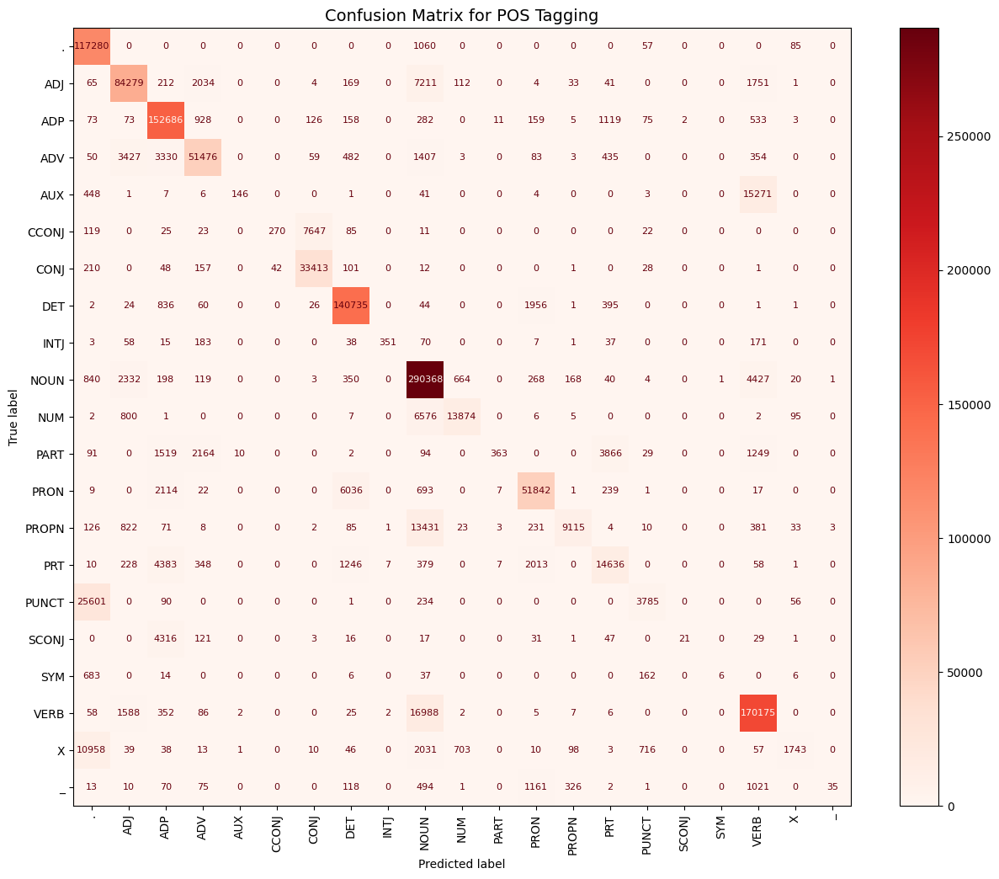

In [79]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import numpy as np
import matplotlib.pyplot as plt

# Actual POS tags
y_true = [tag for sentence in tags for tag in sentence]
# Predicted POS tags
y_pred = [pred for sentence in output_df for pred in sentence]

# Compute the confusion matrix
cm = confusion_matrix(y_true, y_pred, labels=np.unique(y_true))

fig, ax = plt.subplots(figsize=(15, 12))

# To plot confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=np.unique(y_true))
disp.plot(cmap="Reds", values_format="d", ax=ax)

plt.xticks(rotation=90, fontsize=10)
plt.yticks(fontsize=10)
plt.title("Confusion Matrix for POS Tagging", fontsize=14)

for text in ax.texts:
    text.set_fontsize(8)

plt.show()


In [80]:
accuracy = np.trace(cm) / np.sum(cm)

print(f"Model Accuracy: {accuracy * 100:.2f}%")

Model Accuracy: 86.21%


---
Extra:
This was done to see what we got wrong and all
---

In [ ]:
# It calculates the value of tags correctly guessed i.e. truepositive, count is the total number of tags present in the test dataset. It also maintains the error list for which we got wrong tags with their respective sentence index stored in nos list
truePositive = 0
count = 0
error_list = []
nos =[]
for i in range(len(tags)):
  fs = True
  cnt = 0
  for j in range(len(tags[i])):
    if(tags[i][j] == output_df[i][j]):
      truePositive += 1
    else:
      error_list.append((tags[i][j], output_df[i][j],sentence[i][j], preprocessed_sentence[i][j]))
      fs = False
    if(fs == False and cnt < 1):
      cnt += 1
      nos.append(i)
    count += 1


In [ ]:
print(error_list)

[('NUM', 'NOUN', '1', '1'), ('PUNCT', '.', '!', '<PUNCT>'), ('PROPN', 'NOUN', 'esso', 'esso'), ('PROPN', 'ADJ', 'white', 'white'), ('PROPN', 'NOUN', 'tuesday', 'tuesday'), ('X', '.', '.', '<PUNCT>'), ('ADJ', 'NOUN', 'other', 'other'), ('X', '.', '.', '<PUNCT>'), ('AUX', 'VERB', 'can', 'can'), ('INTJ', 'VERB', 'please', 'please'), ('PUNCT', '.', '(', '<SPECIAL_CHAR>'), ('CCONJ', 'CONJ', 'or', 'or'), ('PROPN', 'NOUN', 'jeff', 'jeff'), ('PROPN', 'NOUN', 'hodge', 'hodge'), ('PUNCT', '.', ')', '<SPECIAL_CHAR>'), ('PUNCT', '.', '?', '<PUNCT>'), ('PRT', 'ADP', 'to', 'to'), ('VERB', 'NOUN', 'dance', 'dance'), ('ADJ', 'NOUN', 'fiber', 'fiber'), ('NOUN', 'ADJ', 'double', 'double'), ('PRT', 'ADV', 'well', 'well'), ('ADJ', 'ADV', 'sure', 'sure'), ('ADV', 'ADJ', 'enough', 'enough'), ('NOUN', 'VERB', 'lay', 'lay'), ('PRT', 'PRON', 'there', 'there'), ('NUM', 'NOUN', '1', '1'), ('PRT', 'DET', 'all', 'all'), ('NUM', 'ADJ', 'three', 'three'), ('CCONJ', 'CONJ', 'but', 'but'), ('ADJ', 'NOUN', 'general', '

In [ ]:
print(nos)

[2, 3, 5, 8, 10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 27, 28, 29, 30, 32, 33, 34, 36, 38, 39, 40, 41, 42, 43, 44, 45, 46, 48, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 66, 67, 68, 70, 71, 72, 73, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 88, 89, 90, 91, 95, 96, 97, 98, 99, 100, 101, 103, 104, 106, 107, 109, 113, 115, 116, 119, 120, 121, 123, 125, 126, 130, 131, 132, 133, 134, 136, 137, 138, 140, 141, 142, 143, 146, 147, 148, 151, 152, 153, 154, 156, 157, 159, 160, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 174, 176, 178, 180, 182, 183, 184, 185, 186, 187, 188, 189, 190, 193, 195, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 209, 211, 212, 213, 219, 220, 222, 223, 224, 225, 226, 227, 229, 230, 231, 232, 235, 236, 237, 238, 239, 240, 241, 244, 247, 248, 250, 253, 254, 255, 256, 261, 263, 264, 265, 266, 269, 270, 271, 273, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 296, 297, 299, 300, 301, 302, 303, 30

In [ ]:
print(sentence[19])

['what', 'to', 'do', 'in', 'san', 'rafael', 'can', '?']


In [ ]:
print(count)

1318475


In [ ]:
print(truePositive)

1136599


In [ ]:
# This calculate the accuracy of the HMM model with Viterbi Algo
print(f'Accuracy of Model: {(truePositive*100)/count} %')

0.862055784144561
